In [70]:
import numpy as np 
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px


#clustering algorithms
from sklearn.cluster import KMeans
from collections import Counter
import sklearn
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

from scipy.cluster.hierarchy import linkage
from scipy.cluster.hierarchy import dendrogram
from scipy.cluster.hierarchy import cut_tree

In [3]:
#Loading data
df=pd.read_excel("SpotifyFeatures.xlsx")
df.head()

,genre,artist_name,track_name,track_id,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,time_signature,valence
0,Movie,Henri Salvador,C'est beau de faire un Show,0BRjO6ga9RKCKjfDqeFgWV,0,0.611,0.389,99373,0.910,0.000,C#,0.3460,-1.828,Major,0.0525,166.969,2022-04-04 00:00:00,0.814
1,Movie,Martin & les fées,Perdu d'avance (par Gad Elmaleh),0BjC1NfoEOOusryehmNudP,1,0.246,0.590,137373,0.737,0.000,F#,0.1510,-5.559,Minor,0.0868,174.003,2022-04-04 00:00:00,0.816
2,Movie,Joseph Williams,Don't Let Me Be Lonely Tonight,0CoSDzoNIKCRs124s9uTVy,3,0.952,0.663,170267,0.131,0.000,C,0.1030,-13.879,Minor,0.0362,99.488,2022-05-04 00:00:00,0.368
3,Movie,Henri Salvador,Dis-moi Monsieur Gordon Cooper,0Gc6TVm52BwZD07Ki6tIvf,0,0.703,0.240,152427,0.326,0.000,C#,0.0985,-12.178,Major,0.0395,171.758,2022-04-04 00:00:00,0.227
4,Movie,Fabien Nataf,Ouverture,0IuslXpMROHdEPvSl1fTQK,4,0.950,0.331,82625,0.225,0.123,F,0.2020,-21.150,Major,0.0456,140.576,2022-04-04 00:00:00,0.390


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 232725 entries, 0 to 232724
Data columns (total 18 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   genre             232725 non-null  object 
 1   artist_name       232725 non-null  object 
 2   track_name        232720 non-null  object 
 3   track_id          232725 non-null  object 
 4   popularity        232725 non-null  int64  
 5   acousticness      232725 non-null  float64
 6   danceability      232725 non-null  float64
 7   duration_ms       232725 non-null  int64  
 8   energy            232725 non-null  float64
 9   instrumentalness  232725 non-null  float64
 10  key               232725 non-null  object 
 11  liveness          232725 non-null  float64
 12  loudness          232725 non-null  float64
 13  mode              232725 non-null  object 
 14  speechiness       232725 non-null  float64
 15  tempo             232725 non-null  float64
 16  time_signature    23

In [11]:
df.describe()

,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence
count,232725.000000,232725.000000,232725.000000,2.327250e+05,232725.000000,232725.000000,232725.000000,232725.000000,232725.000000,232725.000000,232725.000000
mean,41.127502,0.368560,0.554364,2.351223e+05,0.570958,0.148301,0.215009,-9.569885,0.120765,117.666585,0.454917
std,18.189948,0.354768,0.185608,1.189359e+05,0.263456,0.302768,0.198273,5.998204,0.185518,30.898907,0.260065
min,0.000000,0.000000,0.056900,1.538700e+04,0.000020,0.000000,0.009670,-52.457000,0.022200,30.379000,0.000000
25%,29.000000,0.037600,0.435000,1.828570e+05,0.385000,0.000000,0.097400,-11.771000,0.036700,92.959000,0.237000
50%,43.000000,0.232000,0.571000,2.204270e+05,0.605000,0.000044,0.128000,-7.762000,0.050100,115.778000,0.444000
75%,55.000000,0.722000,0.692000,2.657680e+05,0.787000,0.035800,0.264000,-5.501000,0.105000,139.054000,0.660000
max,100.000000,0.996000,0.989000,5.552917e+06,0.999000,0.999000,1.000000,3.744000,0.967000,242.903000,1.000000


In [5]:
#missing value 
df.isnull().sum()

genre               0
artist_name         0
track_name          5
track_id            0
popularity          0
acousticness        0
danceability        0
duration_ms         0
energy              0
instrumentalness    0
key                 0
liveness            0
loudness            0
mode                0
speechiness         0
tempo               0
time_signature      0
valence             0
dtype: int64

In [6]:
#dropping na record
df=df.dropna()
df.isnull().sum()

genre               0
artist_name         0
track_name          0
track_id            0
popularity          0
acousticness        0
danceability        0
duration_ms         0
energy              0
instrumentalness    0
key                 0
liveness            0
loudness            0
mode                0
speechiness         0
tempo               0
time_signature      0
valence             0
dtype: int64

In [19]:
df.shape

(232720, 18)

In [7]:
#getting the numeric data 
numeric_data = df._get_numeric_data()
numeric_data.head()

,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence
0,0,0.611,0.389,99373,0.910,0.000,0.3460,-1.828,0.0525,166.969,0.814
1,1,0.246,0.590,137373,0.737,0.000,0.1510,-5.559,0.0868,174.003,0.816
2,3,0.952,0.663,170267,0.131,0.000,0.1030,-13.879,0.0362,99.488,0.368
3,0,0.703,0.240,152427,0.326,0.000,0.0985,-12.178,0.0395,171.758,0.227
4,4,0.950,0.331,82625,0.225,0.123,0.2020,-21.150,0.0456,140.576,0.390


# Performing EDA

**categorical data**

In [14]:
df['genre'].value_counts()
#df.groupby('genre')['track_id'].nunique()

Comedy              9681
Soundtrack          9646
Indie               9541
Jazz                9441
Pop                 9386
Electronic          9377
Children’s Music    9353
Folk                9298
Hip-Hop             9295
Rock                9272
Alternative         9263
Classical           9256
Rap                 9232
World               9096
Soul                9089
Blues               9023
R&B                 8992
Anime               8934
Reggaeton           8927
Ska                 8874
Reggae              8771
Dance               8701
Country             8664
Opera               8280
Movie               7806
Children's Music    5403
A Capella            119
Name: genre, dtype: int64

<AxesSubplot: title={'center': 'Genres'}>

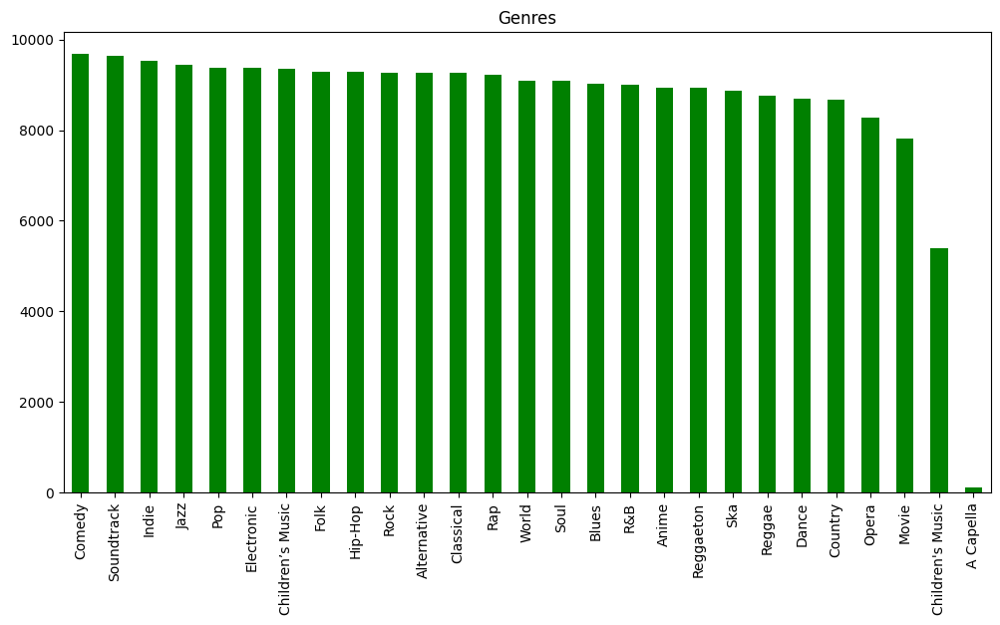

In [21]:
plt.figure(figsize=(12, 6))
df['genre'].value_counts().plot(kind="bar", color="Green", title="Genres")

In [40]:
px.pie(df.genre,
       labels = df.genre.value_counts().index,
       values = df.genre.value_counts().values,
       names = df.genre.value_counts().index,
       title = "Distribution of Genres on Spotify"
      )

C:\Python\Python311\Lib\site-packages\plotly\express\_core.py:137: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  return args["labels"][column]


In [41]:
px.box(data_frame = df, y = 'duration_ms', color='genre')

<AxesSubplot: xlabel='genre', ylabel='popularity'>

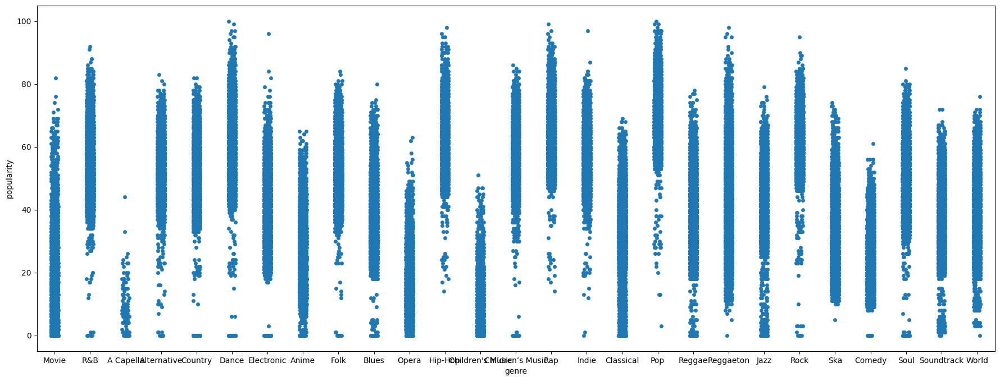

In [30]:
plt.figure(figsize=(22, 8))
sns.stripplot(x='genre', y='popularity', data=df)

<AxesSubplot: xlabel='genre', ylabel='popularity'>

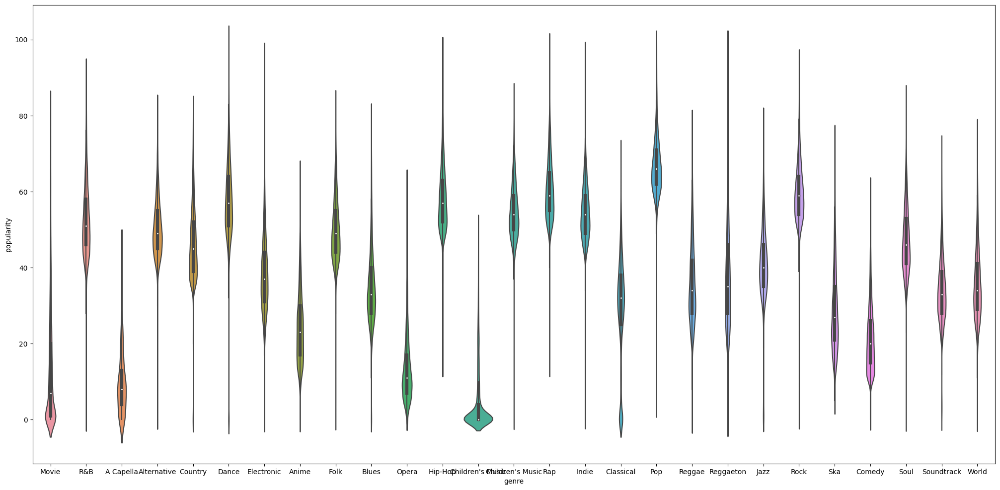

In [33]:
plt.figure(figsize=(25, 12))
sns.violinplot(x='genre', y='popularity', data=df)

**Numerical Value**

array([[<AxesSubplot: title={'center': 'popularity'}>,
        <AxesSubplot: title={'center': 'acousticness'}>],
       [<AxesSubplot: title={'center': 'danceability'}>,
        <AxesSubplot: title={'center': 'duration_ms'}>],
       [<AxesSubplot: title={'center': 'energy'}>,
        <AxesSubplot: title={'center': 'instrumentalness'}>],
       [<AxesSubplot: title={'center': 'liveness'}>,
        <AxesSubplot: title={'center': 'loudness'}>],
       [<AxesSubplot: title={'center': 'speechiness'}>,
        <AxesSubplot: title={'center': 'tempo'}>],
       [<AxesSubplot: title={'center': 'valence'}>, <AxesSubplot: >],
       [<AxesSubplot: >, <AxesSubplot: >]], dtype=object)

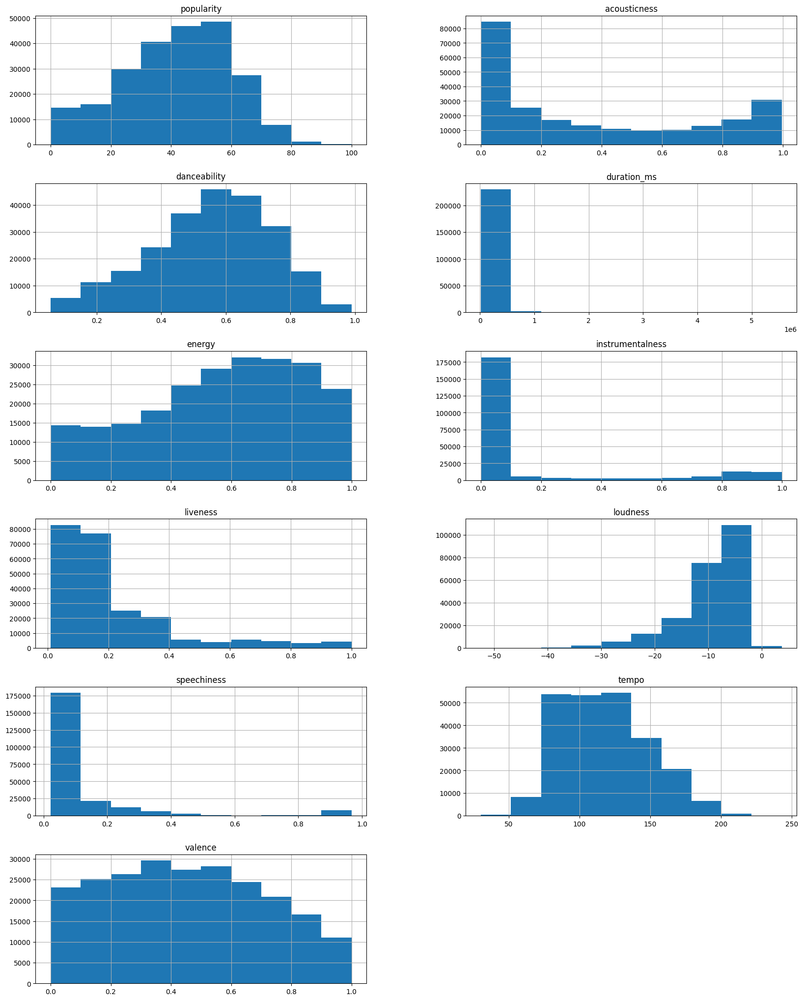

In [21]:
#distribution
numeric_data.hist(layout=(7,2),figsize=(20, 30))

<AxesSubplot: >

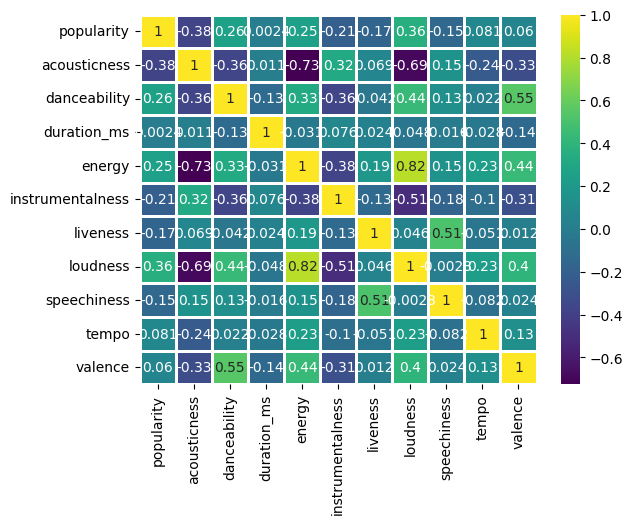

In [9]:
#understaing the relationship between variables
numeric_data.corr()
sns.heatmap(numeric_data.corr(), annot=True,linecolor='white',cmap='viridis', lw=1)

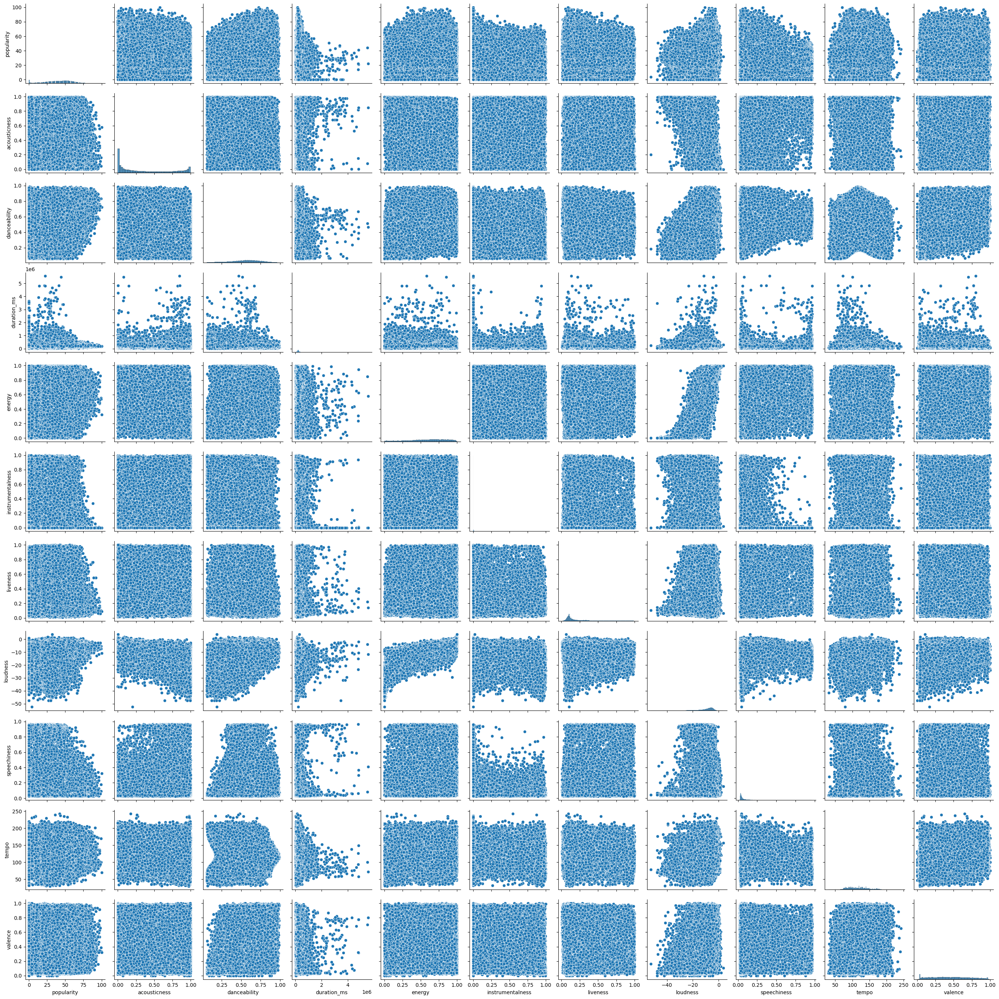

In [10]:
sns.pairplot(numeric_data)

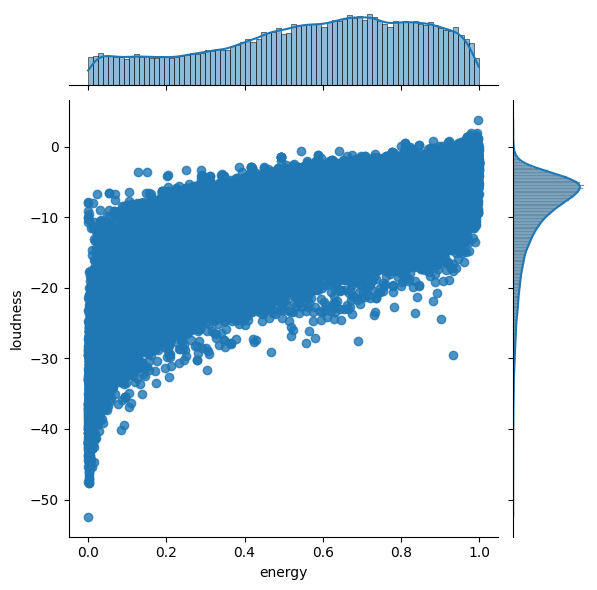

In [11]:
# energy & Loudness relationship
sns.jointplot(x='energy' , y='loudness' , data=numeric_data, kind='reg')

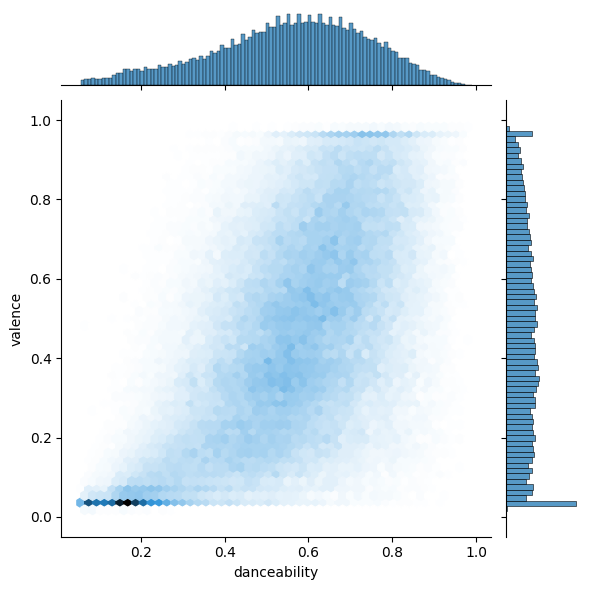

In [13]:
#danceability & valence relationship
sns.jointplot(x='danceability' , y='valence' , data=numeric_data, kind='hex')

C:\Users\eiman\AppData\Local\Temp\ipykernel_11124\2594254796.py:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




<AxesSubplot: xlabel='danceability', ylabel='Density'>

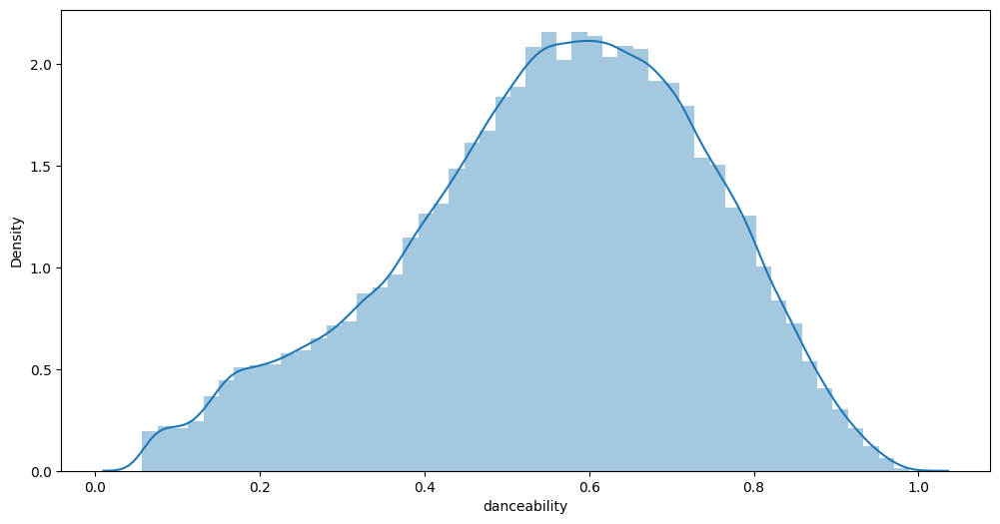

In [72]:
plt.figure(figsize=(12, 6))
sns.distplot(numeric_data.danceability, bins=50)

C:\Users\eiman\AppData\Local\Temp\ipykernel_11124\2927974897.py:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




<AxesSubplot: xlabel='energy', ylabel='Density'>

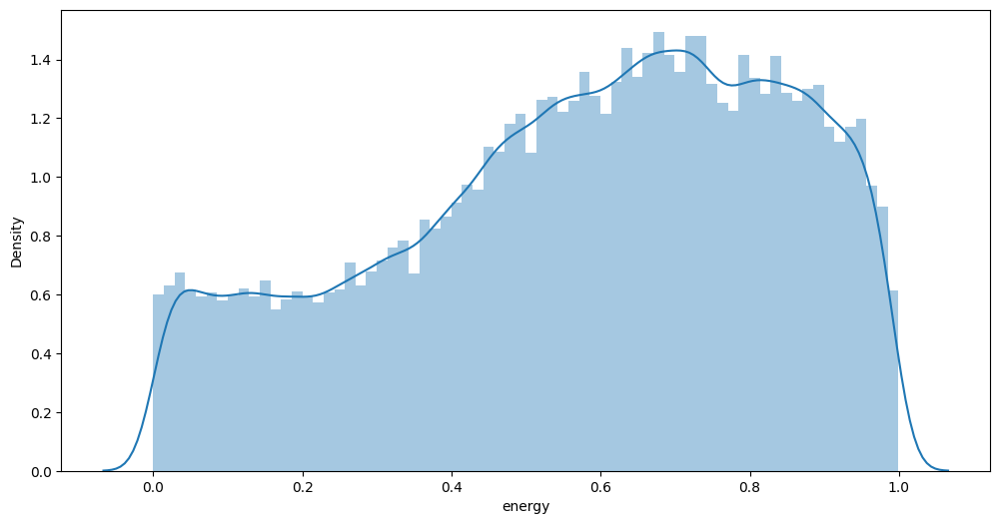

In [73]:
plt.figure(figsize=(12, 6))
sns.distplot(numeric_data.energy, bins=70)

# Clustering Analysis

**K-Means**

In [77]:
df.columns

Index(['genre', 'artist_name', 'track_name', 'track_id', 'popularity',
       'acousticness', 'danceability', 'duration_ms', 'energy',
       'instrumentalness', 'key', 'liveness', 'loudness', 'mode',
       'speechiness', 'tempo', 'time_signature', 'valence'],
      dtype='object')

In [86]:
#numerical value / scaled the numbers 
Songs_clust = df.drop(['genre','artist_name', 'track_name', 'track_id','key','mode','time_signature'],axis=1)
scaler = StandardScaler()
Songs_clust_scaled = scaler.fit_transform(Songs_clust)
Songs_clust_scaled = pd.DataFrame(Songs_clust_scaled)
Songs_clust_scaled.columns = list(df.drop(['genre','artist_name', 'track_name', 'track_id','key','mode','time_signature'],axis=1).columns)
Songs_clust_scaled.head()

,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence
0,-2.261000,0.683372,-0.890930,-1.141366,1.286918,-0.489816,0.660651,1.290710,-0.367966,1.595632,1.380733
1,-2.206024,-0.345472,0.191989,-0.821868,0.630255,-0.489816,-0.322836,0.668690,-0.183079,1.823281,1.388423
2,-2.096074,1.644565,0.585288,-0.545301,-1.669965,-0.489816,-0.564925,-0.718393,-0.455827,-0.588326,-0.334219
3,-2.261000,0.942697,-1.693691,-0.695296,-0.929795,-0.489816,-0.587621,-0.434808,-0.438040,1.750624,-0.876390
4,-2.041098,1.638928,-1.203414,-1.282180,-1.313165,-0.083567,-0.065617,-1.930590,-0.405159,0.741448,-0.249625


In [87]:
range_n_clusters = [2, 3, 4, 5, 6, 7, 8]

for num_clusters in range_n_clusters:
    
    # intialise kmeans
    kmeans = KMeans(n_clusters=num_clusters, max_iter=50)
    kmeans.fit(Songs_clust_scaled)
    
    cluster_labels = kmeans.labels_
    
    # silhouette score
    silhouette_avg = silhouette_score(Songs_clust_scaled, cluster_labels)
    print("For n_clusters={0}, the silhouette score is {1}".format(num_clusters, silhouette_avg))

For n_clusters=2, the silhouette score is 0.305570064026942
For n_clusters=3, the silhouette score is 0.33452524614939494
For n_clusters=4, the silhouette score is 0.18604374054481135
For n_clusters=5, the silhouette score is 0.15599277513383103
For n_clusters=6, the silhouette score is 0.13949453554626212
For n_clusters=7, the silhouette score is 0.14631175707562494
For n_clusters=8, the silhouette score is 0.14947186197712586


**6 clusters has better result** 

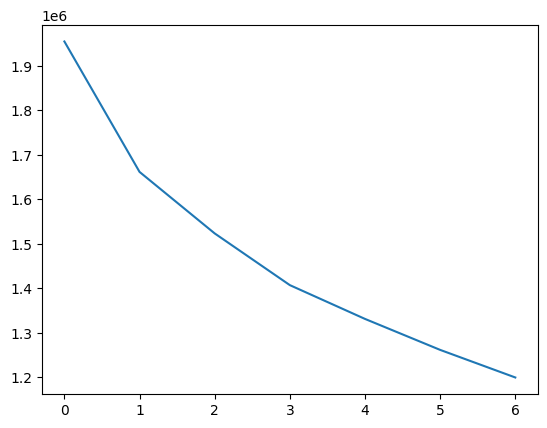

In [88]:
ssd = []
range_n_clusters = [2, 3, 4, 5, 6, 7, 8]
for num_clusters in range_n_clusters:
    kmeans = KMeans(n_clusters=num_clusters, max_iter=50)
    kmeans.fit(Songs_clust_scaled)
    
    ssd.append(kmeans.inertia_)
    
plt.plot(ssd)
plt.show()

In [89]:
kmeans = KMeans(n_clusters=6, max_iter=50)
kmeans.fit(Songs_clust_scaled)

KMeans(max_iter=50, n_clusters=6)

In [90]:
df['cluster_id'] = kmeans.labels_
df.head()

,genre,artist_name,track_name,track_id,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,time_signature,valence,cluster_id
0,Movie,Henri Salvador,C'est beau de faire un Show,0BRjO6ga9RKCKjfDqeFgWV,0,0.611,0.389,99373,0.910,0.000,C#,0.3460,-1.828,Major,0.0525,166.969,2022-04-04 00:00:00,0.814,1
1,Movie,Martin & les fées,Perdu d'avance (par Gad Elmaleh),0BjC1NfoEOOusryehmNudP,1,0.246,0.590,137373,0.737,0.000,F#,0.1510,-5.559,Minor,0.0868,174.003,2022-04-04 00:00:00,0.816,1
2,Movie,Joseph Williams,Don't Let Me Be Lonely Tonight,0CoSDzoNIKCRs124s9uTVy,3,0.952,0.663,170267,0.131,0.000,C,0.1030,-13.879,Minor,0.0362,99.488,2022-05-04 00:00:00,0.368,3
3,Movie,Henri Salvador,Dis-moi Monsieur Gordon Cooper,0Gc6TVm52BwZD07Ki6tIvf,0,0.703,0.240,152427,0.326,0.000,C#,0.0985,-12.178,Major,0.0395,171.758,2022-04-04 00:00:00,0.227,3
4,Movie,Fabien Nataf,Ouverture,0IuslXpMROHdEPvSl1fTQK,4,0.950,0.331,82625,0.225,0.123,F,0.2020,-21.150,Major,0.0456,140.576,2022-04-04 00:00:00,0.390,3


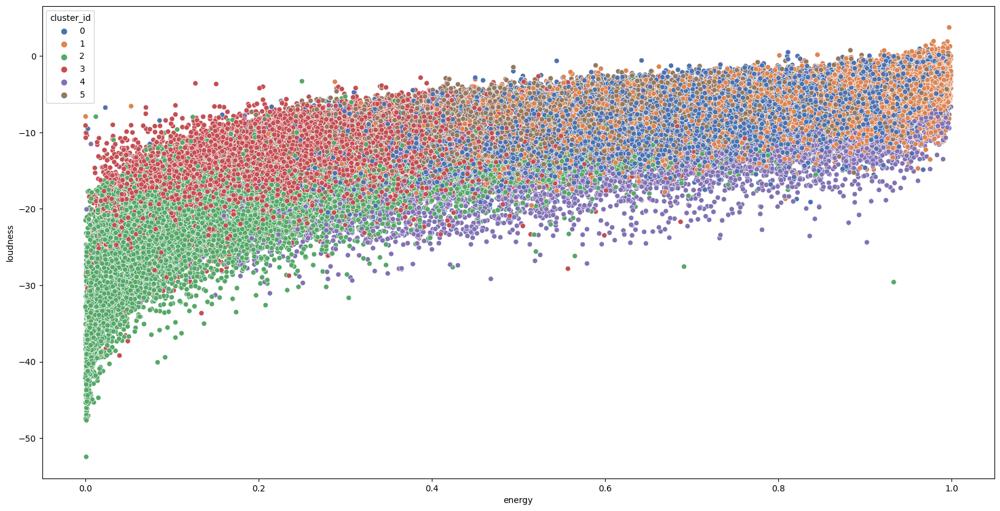

In [91]:
plt.figure(figsize=(20,10))
sns.scatterplot(x = 'energy',y = 'loudness', data = df, hue = 'cluster_id',palette='deep')
plt.show()

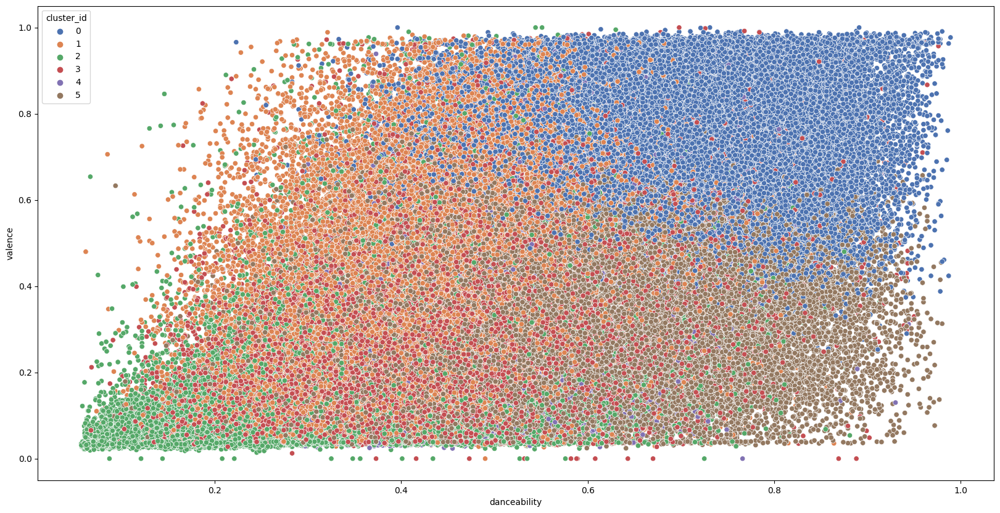

In [92]:
plt.figure(figsize=(20,10))
sns.scatterplot(x = 'danceability',y = 'valence', data = df, hue = 'cluster_id',palette='deep')
plt.show()

In [93]:
df.to_csv('spotify.csv', sep='\t')